# Analítica para una variable

Continuamos con los mismos datos del cuaderno anterior. Pero ahora nos concentraremos en entender algunos fundamentos aplicados de analizar una variable. Recuerde que los datos corresponden al trabajo de Correa y cols (2019) sobre la relación entre las condiciones del tráfico y el cumplimiento en la entrega de comida a domicilio en Bogotá.

In [1]:
# pip install altair # Para instalar la librería altair borre el hashtag y corra esta celda

In [2]:
import altair as alt # Librería para hacer los gráficos
import pandas as pd # Librería para abrir los datos
import numpy as np
import matplotlib.pyplot as plt # Librería para resumir datos con gráficos
plt.rcParams['figure.dpi'] = 150 # Para mejorar la resolución gráfica
plt.rcParams['savefig.dpi'] = 150 # Para mejorar la resolución gráfica

Ahora vamos a abrir los mismos datos que vimos en el cuaderno anterior y con la opción datos.head() podemos ver las primeras cuatro filas de tales datos.

In [3]:
datos = pd.read_csv("newdata.csv")
datos.head()

,Moment,number,web,Name of Provider,Number of Comments,Expected Delivery Time,Minimum Charge Ordering,Cost Delivery,Latitude,Longitude,Typical Traffic Afternoon,Typical Traffic Noon,Typical Traffic Morning,DailyTraffic,ClientLatitude,ClientLongitude,Distance(mts),Time(sec),Time(min)
0,Morning,1,https://domicilios.com/bogota/kfc-cc-atlantis-...,KFC,5329.0,45.0,9900.0,3500.0,4.66597,-74.05558,Red,Orange,Green,ROG,4.665798,-74.040855,2500,660,11.0
1,Morning,1,https://domicilios.com/bogota/kfc-cc-atlantis-...,KFC,5329.0,45.0,9900.0,3500.0,4.66597,-74.05558,Red,Orange,Green,ROG,4.666159,-74.038331,3300,720,12.0
2,Morning,1,https://domicilios.com/bogota/kfc-cc-atlantis-...,KFC,5329.0,45.0,9900.0,3500.0,4.66597,-74.05558,Red,Orange,Green,ROG,4.670228,-74.026783,9100,1740,29.0
3,Morning,1,https://domicilios.com/bogota/kfc-cc-atlantis-...,KFC,5329.0,45.0,9900.0,3500.0,4.66597,-74.05558,Red,Orange,Green,ROG,4.662140,-74.008008,9700,1740,29.0
4,Morning,1,https://domicilios.com/bogota/kfc-cc-atlantis-...,KFC,5329.0,45.0,9900.0,3500.0,4.66597,-74.05558,Red,Orange,Green,ROG,4.669905,-74.104917,8800,1320,22.0


Una de las primeras cosas que debemos saber es cuántas observaciones están presentes en la base de datos. Para ello, hacemos la siguiente sintaxis

In [4]:
len(datos)

19934

Vemos claramente que la base de datos tiene un total de 19934 observaciones. Si este número se mantiene igual al analizar otras variables, no tendremos necesidad de hacer ningún análisis posterior más allá de resumir con tablas y gráficos. En caso contrario, tendremos que ver qué pudo haber pasado con los datos (usualmente casos perdidos).

## Resumir datos para una variable

En la analítica de datos, una de las tareas más comunes es resumir datos de las variables que mayor interesan a un negocio. Por ejemplo, podríamos estar interesados en conocer el comportamiento estadístico del costo del domicilio. Para ello, podríamos solicitar un resumen de la variable haciendo los cálculos de los estadísticos descriptivos y disponerlos en una tabla.

In [5]:
datos['Cost Delivery'].describe()

count    14271.000000
mean      2580.827116
std       1411.358955
min          0.000000
25%       2000.000000
50%       2800.000000
75%       3200.000000
max      15000.000000
Name: Cost Delivery, dtype: float64

In [6]:
2850.82+1411.35

4262.17

En promedio, el costo del servicio de entrega de comida a domicilio era de 2580.82 pesos Colombianos, con una desviación estándar de 1411.35 pesos por encima y por debajo de este promedio. Esto ubica a la mayoría de los domicilios entre 1439.47 y los 4262.17 pesos, aunque se observan domicilios con ningún costo y 15000 pesos. Del resultado anterior, también podemos afirmar que hay datos perdidos, pues en la base de datos original se había observado un total de 19934 observaciones, mientras que el total de observaciones para Cost Delivery es de 14271 observaciones. Para verificar esto podemos proceder con la siguiente sintaxis.

In [7]:
datos["Cost Delivery"].isna().sum()

5663

Otra forma de resumir los datos es a través de gráficos. Por ejemplo, podríamos sacar un histograma sencillo como el siguiente.

<AxesSubplot:>

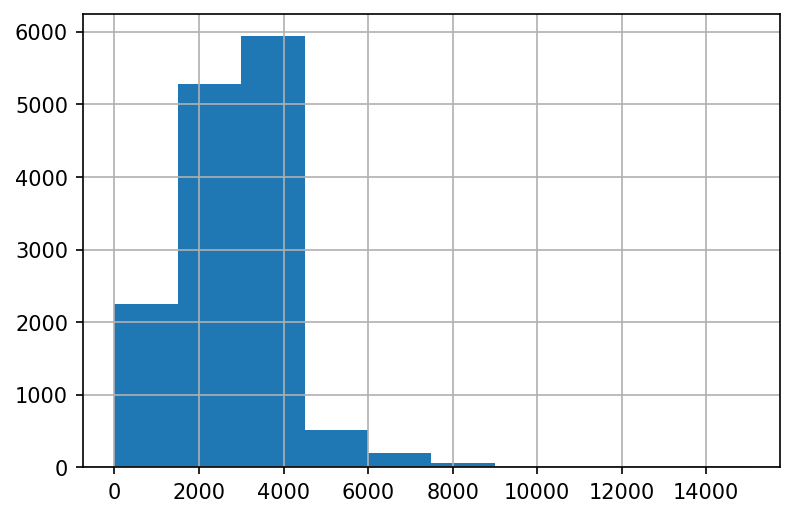

In [8]:
datos['Cost Delivery'].hist()

El histograma anterior nos muestra el comportamiento estadístico de la variable Cost Delivery. Como puede apreciarse en dicho histograma la identificación de los ejes no es clara. Se sobre entiende que el eje horizontal es en pesos colombianos y en el eje vertical tenemos el conteo de casos. Sin embargo, para alguien que no esté familiarizado con los datos, estos detalles no son evidentes. Por ello, conviene tomar la previsión de incluir siempre la identificación de las variables en cada eje, de la siguiente manera.

In [9]:
alt.Chart(datos).mark_bar().encode(
alt.X("Cost Delivery", bin=True),
y='count()',
)

MaxRowsError: The number of rows in your dataset is greater than the maximum allowed (5000). For information on how to plot larger datasets in Altair, see the documentation

alt.Chart(...)

El error anterior se debe a que la librería altair nos permite sacar un histograma con datos que no excedan las 5000 observaciones. Pero al buscar en internet la documentación de la librería altair y como cambiar esta restricción, encontramos que la solución requiere la siguiente función.

In [10]:
alt.data_transformers.enable('default', max_rows=None)

DataTransformerRegistry.enable('default')

In [11]:
alt.Chart(datos).mark_bar().encode(
alt.X("Cost Delivery", bin=True),
y='count()',
)

alt.Chart(...)

Podemos incluso cambiar el color de las barras de este histograma de la siguiente manera.

In [12]:
alt.Chart(datos).mark_bar().encode(
alt.X("Cost Delivery", bin=True),
y='count()',).configure_mark(
    opacity=0.6,
    color='green'
)

alt.Chart(...)

Viendo el histograma anterior, es obvio que los costos de delivery por encima de los 8
o 10 mil pesos están muy alejados de la mayoría de los costos que se concentran alrededor
de los 4 mil pesos. Este solo histograma ya debería ser suficiente para los propietarios de
restaurantes a la hora de fijar sus precios de costo por la entrega de comida a domicilio. Sin embargo, podríamos también obtener un gráfico de caja y bigote (boxplot) para entender más precisamente donde se concentran la mayoría de los costos de domicilios.

In [13]:
alt.Chart(datos).mark_boxplot().encode(
    x='Cost Delivery',
)

alt.Chart(...)

In [14]:
alt.Chart(datos).mark_boxplot().encode(
    x='Cost Delivery',
).configure_mark(
    opacity=0.9,
    color='red'
)

alt.Chart(...)